<a href="https://colab.research.google.com/github/klordo/deep_gen_models_hws/blob/hw3/gen_hw3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Sampling в латентном пространстве StyleGAN

In [ ]:
!pip install ninja
!pip install imageio-ffmpeg
!pip install -U -q PyDrive
!pip install lpips
!pip install pytorch_msssim
!pip install pytorch-ignite


from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

%mkdir raw_images
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch
%cd stylegan2-ada-pytorch
!git clone https://github.com/denkogit/stylegan2_models


!mkdir pretrained_models
%cd pretrained_models
!wget https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl
!wget https://github.com/davisking/dlib-models/raw/master/shape_predictor_68_face_landmarks.dat.bz2
!bzip2 -d /content/stylegan2-ada-pytorch/pretrained_models/shape_predictor_68_face_landmarks.dat.bz2

file_id = '1cUv_reLE6k3604or78EranS7XzuVMWeO' # URL id.
downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile('e4e_ffhq_encode.pt')

%cd ..

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Выравнивание изображений (Align images)

In [ ]:
import os
from stylegan2_models.image_aligner.face_alignment import image_align
from stylegan2_models.image_aligner.landmarks_detector import LandmarksDetector

In [ ]:
landmarks_model_path = "/content/stylegan2-ada-pytorch/pretrained_models/shape_predictor_68_face_landmarks.dat"
RAW_IMAGES_DIR = "/content/drive/MyDrive/celebs"
ALIGNED_IMAGES_DIR = "/content/drive/MyDrive/aligned_images"

landmarks_detector = LandmarksDetector(landmarks_model_path)

In [ ]:
for celeb in os.listdir(RAW_IMAGES_DIR):
    celeb_folder = os.path.join(RAW_IMAGES_DIR, celeb)
    save_path = os.path.join(ALIGNED_IMAGES_DIR, celeb)
    os.makedirs(save_path, exist_ok=True)
    for i, img_name in enumerate(os.listdir(celeb_folder)):
      if img_name == ".ipynb_checkpoints":
        continue
      raw_img_path = os.path.join(celeb_folder, img_name)
      for face_landmarks in landmarks_detector.get_landmarks(raw_img_path):
          aligned_face_path = os.path.join(save_path, f"{i}.jpg")
          image_align(raw_img_path, aligned_face_path, face_landmarks)
          break


# Проекция изображений

In [ ]:
import os
os.chdir("/content/stylegan2-ada-pytorch")

In [ ]:
import pickle
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import PIL
import os
import numpy as np
import lpips
import torch.nn as nn
import torchvision.transforms as transforms
from pytorch_msssim import ms_ssim
from tqdm import tqdm
import torch.nn.functional as F
from glob import glob

In [ ]:
def plot_image(tensor, plot_size=(10,10)):
    tensor = (tensor.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    img = Image.fromarray(tensor[0].cpu().numpy(), 'RGB')
    plt.rcParams["figure.figsize"] = plot_size
    plt.imshow(img)


def broadcast_w_sg(w_batch, cast_n=18):
    input_ws = []
    for w in w_batch:
        w_broadcast = torch.broadcast_to(w, (cast_n, 512))
        input_ws.append(w_broadcast)
    return torch.stack(input_ws)

In [ ]:
seed = 2345645
noise_mode = 'const' # шум
label = 0 # для разных моделей
device = "cuda:0"
model_path = "/content/stylegan2-ada-pytorch/pretrained_models/ffhq.pkl"

with open(model_path, 'rb') as f:
    G = pickle.load(f)['G_ema'].cuda()

In [ ]:
class Rec_loss(nn.Module):
    def __init__(self):
        super().__init__()
        self.l1_criterion = torch.nn.L1Loss(reduction='mean')

    def forward(self, target, synth):
        target = torch.add(target, 1.0)
        target = torch.mul(target, 127.5)
        target = target / 255

        synth = torch.add(synth, 1.0)
        synth = torch.mul(synth, 127.5)
        synth = synth / 255

        loss = torch.mean(1 - ms_ssim(synth, target, data_range=1, size_average=True))
        return loss


class Lpips_loss(nn.Module):
    def __init__(self, device):
        super().__init__()
        self.lpips_loss = lpips.LPIPS(net='vgg')
        self.lpips_loss.to(device)
        self.lpips_loss.eval()

    def forward(self, target, synth):
        return torch.mean(self.lpips_loss(target, synth))


class Reg_loss(nn.Module):
    def __init__(self, noise_bufs):
        super().__init__()
        self.noise_bufs = noise_bufs

    def forward(self,):
        reg_loss = 0.0
        for v in self.noise_bufs.values():
            noise = v[None,None,:,:] # must be [1,1,H,W] for F.avg_pool2d()
            while True:
                reg_loss += (noise*torch.roll(noise, shifts=1, dims=3)).mean()**2
                reg_loss += (noise*torch.roll(noise, shifts=1, dims=2)).mean()**2
                if noise.shape[2] <= 8:
                    break
                noise = F.avg_pool2d(noise, kernel_size=2)
        return reg_loss

def image2tensor_norm(image):
    transform = transforms.Compose([transforms.ToTensor(),
                                   transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    tensor = transform(image)
    return tensor

In [ ]:
# Уменьшил lr, увеличил количество шагов, измеил веса
def projection(inv_img_path):
    target_pil = Image.open(inv_img_path).convert('RGB')
    target_tensor = image2tensor_norm(target_pil).to(device).unsqueeze(0)


  # loss
    lpips_loss = Lpips_loss(device)
    rec_loss = Rec_loss()

    noise_bufs = { name: buf for (name, buf) in G.synthesis.named_buffers() if 'noise_const' in name }
    reg_loss = Reg_loss(noise_bufs)

  # loss weights
    regularize_noise_weight = 5e5
    rec_weight = 0.2
    lpips_weoght = 1

  # Параметры для оптимизации
    num_steps = 200
    seed = 42
    initial_learning_rate = 0.006
    w_avg_samples = 10000

    z_samples = torch.from_numpy(np.random.RandomState(seed).randn(w_avg_samples, G.z_dim)).to(device)
    w_samples = G.mapping(z_samples, None)
    w_samples = w_samples[:, :1, :].cpu().numpy().astype(np.float32)
    w_avg = np.mean(w_samples, axis=0, keepdims=True)   # [1, 1, C]
    w_std = (np.sum((w_samples - w_avg) ** 2) / w_avg_samples) ** 0.5

    w_opt = torch.tensor(w_avg, dtype=torch.float32, device=device, requires_grad=False) # pylint: disable=not-callable
    w_opt = broadcast_w_sg(w_opt).requires_grad_(True)

    optimizer = torch.optim.Adam([w_opt], lr=initial_learning_rate)
    generated_tensors = []
    for step in tqdm(range(num_steps)):
        synth_tensor = G.synthesis(broadcast_w_sg(w_opt), noise_mode='const')

        lpips_value = lpips_loss(synth_tensor, target_tensor)
        rec_value = rec_loss(synth_tensor, target_tensor)
        reg_value = reg_loss()

        loss = lpips_value*lpips_weoght + rec_value*rec_weight + reg_value*regularize_noise_weight

        optimizer.step()
        optimizer.zero_grad(set_to_none=True)
        loss.backward()

        generated_tensors.append(synth_tensor)
    generated_tensor = G.synthesis(broadcast_w_sg(w_opt), noise_mode='const', force_fp32=True)

  # save_image(generated_tensor, path="./projected_image.png")
    print(loss.item())
    return generated_tensor

In [ ]:
generated_tensor = projection("/content/drive/MyDrive/aligned_images/MRobbie/0.jpg")

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:07<00:00, 75.1MB/s]


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth
Setting up PyTorch plugin "bias_act_plugin"... Done.



  0%|          | 0/200 [00:00<?, ?it/s]

Setting up PyTorch plugin "upfirdn2d_plugin"... Done.


100%|██████████| 200/200 [02:33<00:00,  1.30it/s]


114595.3359375


In [ ]:
image_list = glob('/content/drive/MyDrive/aligned_images/*/0.jpg')

In [ ]:
tensor_list = []
for i in image_list:
    generated_tensor = projection(i)
    tensor_list.append(generated_tensor)

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [02:01<00:00,  1.65it/s]


114595.3046875
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [02:01<00:00,  1.64it/s]


114595.3046875
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [02:02<00:00,  1.64it/s]


114595.3359375
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [02:01<00:00,  1.64it/s]


114595.2890625


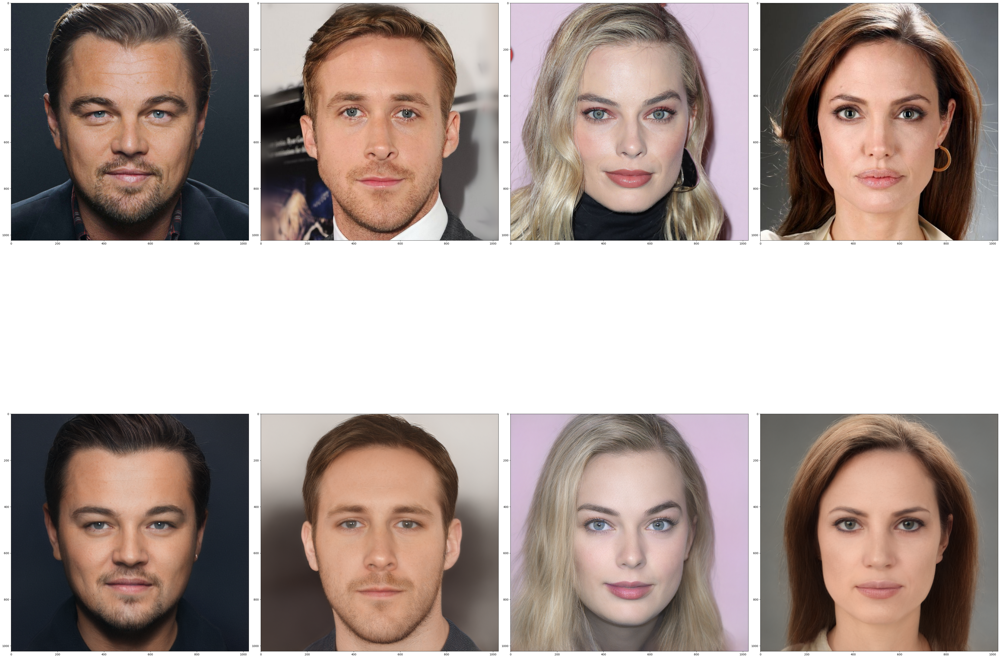

In [ ]:
width = 5
height = 5
rows = 2
cols = 4
axes = []
fig = plt.figure()

for a in range(cols):
    tensor = (tensor_list[a].permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    img_1 = np.asarray(Image.open(image_list[a]))
    plt.rcParams["figure.figsize"] = (50,50)
    axes.append(fig.add_subplot(rows, cols, a + 1))
    plt.imshow(img_1)
    img_2 = Image.fromarray(tensor[0].cpu().numpy(), 'RGB')
    plt.rcParams["figure.figsize"] = (50,50)
    axes.append(fig.add_subplot(rows, cols, a + 5))
    plt.imshow(img_2)
fig.tight_layout()
plt.show()

# Style transfer


In [ ]:
from pathlib import Path
from glob import glob

In [ ]:
style_list = glob('/content/drive/MyDrive/styles/*')

In [ ]:
save_folder = '/content/drive/MyDrive/aligned_styles'
os.makedirs(save_folder, exist_ok=True)
for i in style_list:
    img_name = Path(i).stem
    for face_landmarks in landmarks_detector.get_landmarks(i):
        aligned_face_path = os.path.join(save_folder, f"{img_name}.jpg")
        image_align(i, aligned_face_path, face_landmarks)
        break

In [ ]:
os.listdir('/content/drive/MyDrive/aligned_styles')

['styles_2.jpg', 'styles_3.jpg', 'styles_1.jpg']

In [ ]:
styles_projections = []
for i in os.listdir('/content/drive/MyDrive/aligned_styles'):
    generated_tensor = projection('/content/drive/MyDrive/aligned_styles/'+i)
    styles_projections.append(generated_tensor)

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:07<00:00, 69.2MB/s]


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [02:08<00:00,  1.55it/s]


114595.515625
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [02:03<00:00,  1.61it/s]


114595.34375
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [02:04<00:00,  1.61it/s]


114595.4375


In [ ]:
aligned_style_list = glob('/content/drive/MyDrive/aligned_styles/*')

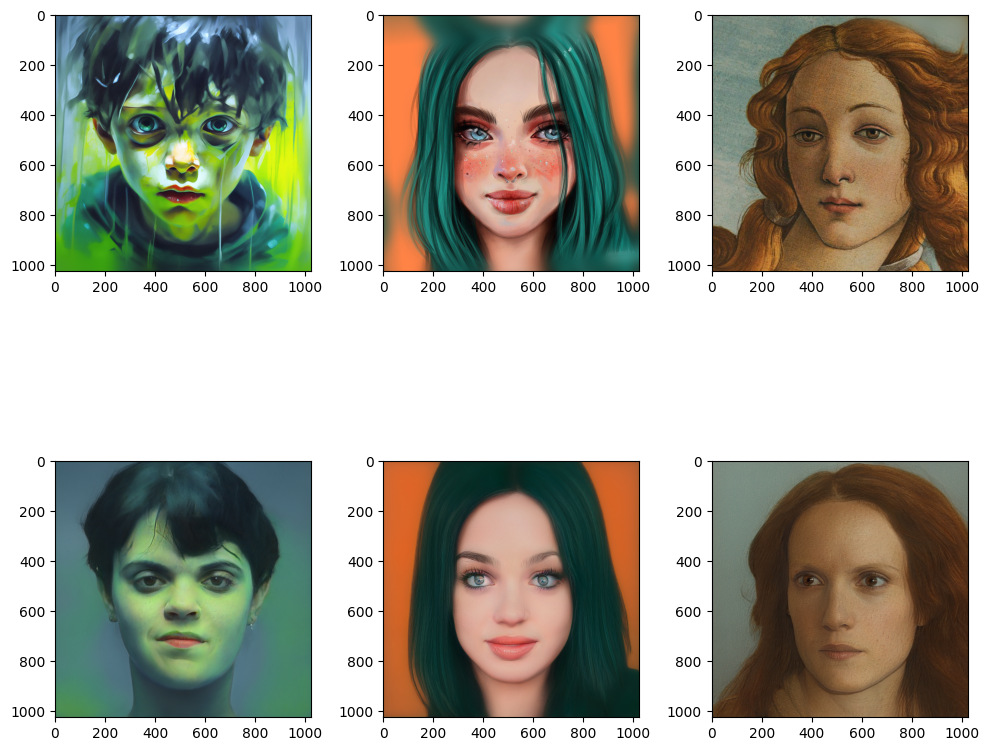

In [ ]:
width = 5
height = 5
rows = 2
cols = 3
axes = []
fig = plt.figure()

for a in range(cols):
    tensor = (styles_projections[a].permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    img_1 = np.asarray(Image.open(aligned_style_list[a]))
    plt.rcParams["figure.figsize"] = (50,50)
    axes.append(fig.add_subplot(rows, cols, a + 1))
    plt.imshow(img_1)
    img_2 = Image.fromarray(tensor[0].cpu().numpy(), 'RGB')
    plt.rcParams["figure.figsize"] = (50,50)
    axes.append(fig.add_subplot(rows, cols, a + 4))
    plt.imshow(img_2)
fig.tight_layout()
plt.show()

In [ ]:
from stylegan2_models.e4e.model_utils import load_e4e_standalone
import torchvision.transforms as transforms

e4e_model, _ = load_e4e_standalone("/content/stylegan2-ada-pytorch/pretrained_models/e4e_ffhq_encode.pt")

image2e4etensor = transforms.Compose([transforms.ToTensor(),
                                transforms.Resize((256, 256)),
                                transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])


In [ ]:
import os
import glob
import pandas as pd
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox


In [ ]:
images_path = "/content/drive/MyDrive/aligned_images"
save_path = "/content/drive/MyDrive/e4e_invertion"

data = []
for persone in sorted(os.listdir(images_path)):
    person_images = os.path.join(images_path, persone)
    save_folder = os.path.join(save_path, persone)
    os.makedirs(save_folder, exist_ok=True)

    for image_name in os.listdir(person_images):
        image_path = os.path.join(person_images, image_name)

        target_pil = Image.open(image_path).convert('RGB')
        target_uint8 = np.array(target_pil, dtype=np.uint8)

        e4e_tensor = image2e4etensor(target_uint8).to(device).unsqueeze(0)

        latent_vector = e4e_model(e4e_tensor).detach().cpu()
        latent_path = os.path.join(save_folder, f"{image_name[:-4]}.pt")

        torch.save(latent_vector, latent_path)
        data.append([persone, image_name, image_path, latent_path])

In [ ]:
images_path = "/content/drive/MyDrive/aligned_styles"
save_folder = "/content/drive/MyDrive/e4e_invertion_styles"
os.makedirs(save_folder, exist_ok=True)
data = []
for persone in sorted(os.listdir(images_path)):
    image_path = images_path + '/' + persone
    image_name = Path(persone).stem

    target_pil = Image.open(image_path).convert('RGB')
    target_uint8 = np.array(target_pil, dtype=np.uint8)

    e4e_tensor = image2e4etensor(target_uint8).to(device).unsqueeze(0)

    latent_vector = e4e_model(e4e_tensor).detach().cpu()
    latent_path = os.path.join(save_folder, f"{image_name}.pt")

    torch.save(latent_vector, latent_path)
    data.append([persone, image_name, image_path, latent_path])

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
%rm -rf /content/e4e_invertion


In [ ]:
from IPython.display import display, FileLink
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import torch
from glob import glob


def interpolate(latent1, latent2, psi=0.5, indeces=[i for i in range(0,18)]):
    init_latent = latent1.clone()
    latent1 = latent1.clone()
    latent2 = latent2.clone()
    for i in indeces:
        latent1[:, i] = latent2[:, i].lerp(latent1[:, i], psi)

    edited_tensor = G.synthesis(latent1, noise_mode='const', force_fp32=True)
    init_tensor = G.synthesis(init_latent, noise_mode='const', force_fp32=True)
    plot_image(torch.cat((init_tensor, edited_tensor ), dim=3), (10,10))
    return edited_tensor


In [ ]:
latent1=torch.load("/content/drive/MyDrive/e4e_invertion/AJolie/1.pt").to(device)
latent2=torch.load("/content/drive/MyDrive/e4e_invertion_styles/styles_3.pt").to(device) # 0.5, 1.5 indeces = [0,1,2,3,4,5,6]
latent2 = broadcast_w_sg(latent2)

indeces = [9,10,11,12,13,14,15,16,17]
edited_tensor = interpolate(latent1, latent2, psi=0.1, indeces=indeces)


In [ ]:
init_tensor=torch.load("/content/drive/MyDrive/e4e_invertion/AJolie/0.pt").to(device)
init_tensor = G.synthesis(init_tensor, noise_mode='const', force_fp32=True)
list_of_tensors = []
for i in glob("/content/drive/MyDrive/e4e_invertion_styles/*.pt"):
    latent1=torch.load("/content/drive/MyDrive/e4e_invertion/AJolie/0.pt").to(device)
    latent2=torch.load(i).to(device) # 0.5, 1.5 indeces = [0,1,2,3,4,5,6]
    latent2 = broadcast_w_sg(latent2)

    indeces = [9,10,11,12,13,14,15,16,17]
    edited = interpolate(latent1, latent2, psi=0.1, indeces=indeces)
    list_of_tensors.append(edited)

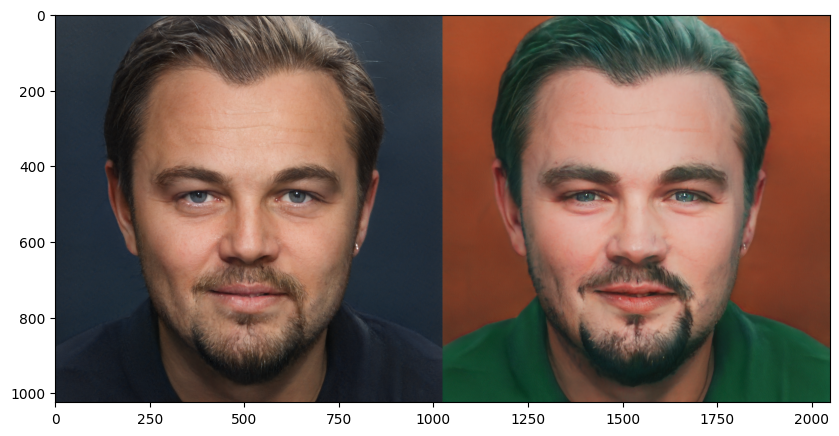

In [ ]:
img_list = []
for im in glob('/content/drive/MyDrive/e4e_invertion/*/0.pt'):
    init_tensor=torch.load(im).to(device)
    init_tensor = G.synthesis(init_tensor, noise_mode='const', force_fp32=True)
    list_of_tensors = []
    list_dir = glob("/content/drive/MyDrive/e4e_invertion_styles/*.pt")
    for i in list_dir:
        latent1=torch.load(im).to(device)
        latent2=torch.load(i).to(device) # 0.5, 1.5 indeces = [0,1,2,3,4,5,6]
        latent2 = broadcast_w_sg(latent2)

        indeces = [9,10,11,12,13,14,15,16,17]
        edited = interpolate(latent1, latent2, psi=0.1, indeces=indeces)
        list_of_tensors.append(edited)
    tensor_im = torch.cat((init_tensor, list_of_tensors[0],list_of_tensors[1],list_of_tensors[2]), dim=3)
    tensor = (tensor_im.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    img_list.append(Image.fromarray(tensor[0].cpu().numpy(), 'RGB'))

Из векторы W были взяты индексы с 10 по 18

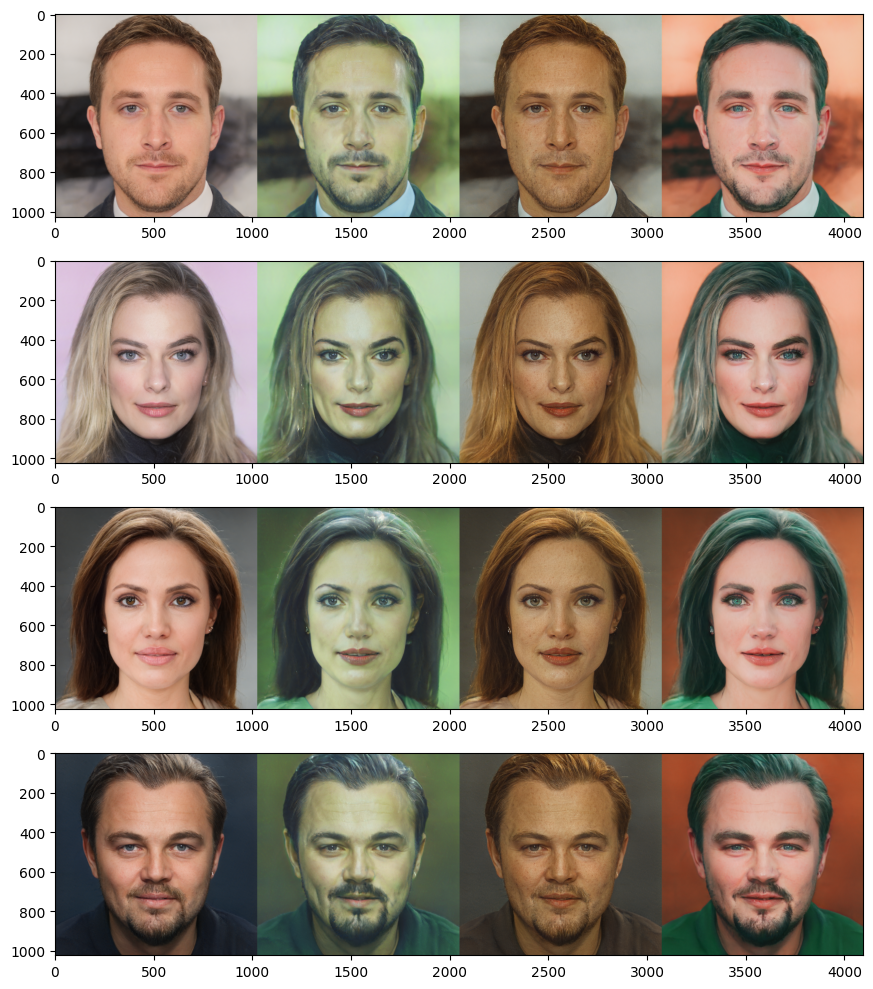

In [ ]:
rows = 4
cols = 1
axes = []
fig = plt.figure()
for i in range(rows):
    img = np.asarray(img_list[i])
    axes.append(fig.add_subplot(rows, cols, i+1))
    plt.imshow(img)
fig.tight_layout()
plt.show()

# Expression transfer

In [ ]:
expression_list = glob('/content/drive/MyDrive/expressions/*')

In [ ]:
save_folder = '/content/drive/MyDrive/aligned_expressions'
os.makedirs(save_folder, exist_ok=True)
for i in expression_list:
    img_name = Path(i).stem
    for face_landmarks in landmarks_detector.get_landmarks(i):
        aligned_face_path = os.path.join(save_folder, f"{img_name}.jpg")
        image_align(i, aligned_face_path, face_landmarks)
        break

Фотографии разных эмоций одного человека, в том числе нейтральная (1 фото справа:)

['/content/drive/MyDrive/aligned_expressions/exp_2.jpg', '/content/drive/MyDrive/aligned_expressions/exp_1.jpg', '/content/drive/MyDrive/aligned_expressions/exp_3.jpg', '/content/drive/MyDrive/aligned_expressions/exp_0.jpg']


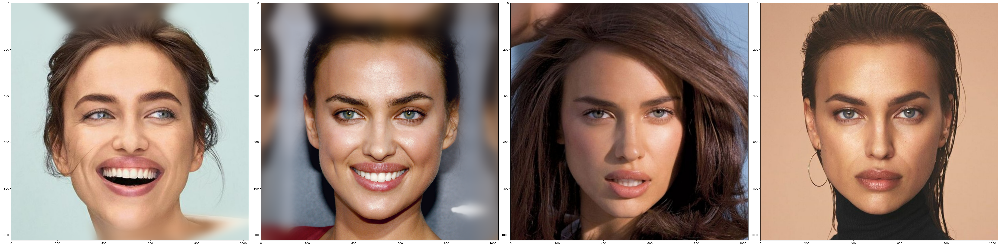

In [ ]:
images_path = glob("/content/drive/MyDrive/aligned_expressions/*")
print(images_path)
rows = 1
cols = 4
axes = []
fig = plt.figure()

for a in range(cols):
    img = Image.open(images_path[a])
    plt.rcParams["figure.figsize"] = (150,150)
    axes.append(fig.add_subplot(rows, cols, a + 1))
    plt.imshow(img)
fig.tight_layout()
plt.show()

In [ ]:
save_folder = "/content/drive/MyDrive/e4e_invertion_expressions"
os.makedirs(save_folder, exist_ok=True)
data = []
for persone in sorted(os.listdir(images_path)):
    image_path = images_path + '/' + persone
    image_name = Path(persone).stem

    target_pil = Image.open(image_path).convert('RGB')
    target_uint8 = np.array(target_pil, dtype=np.uint8)

    e4e_tensor = image2e4etensor(target_uint8).to(device).unsqueeze(0)

    latent_vector = e4e_model(e4e_tensor).detach().cpu()
    latent_path = os.path.join(save_folder, f"{image_name}.pt")

    torch.save(latent_vector, latent_path)
    data.append([persone, image_name, image_path, latent_path])

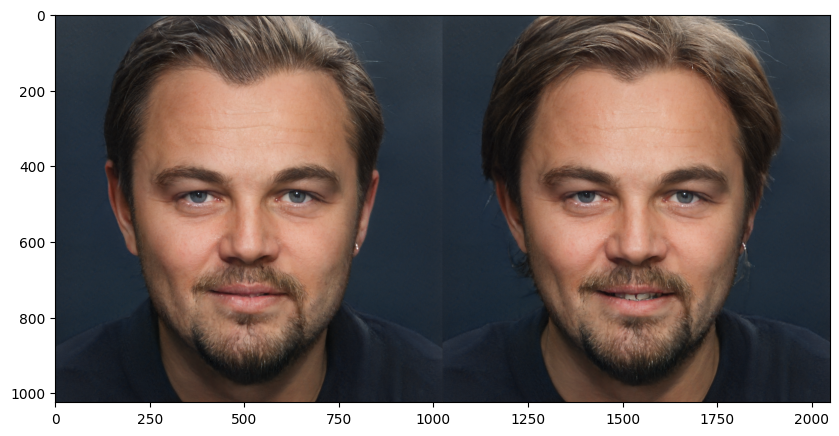

In [ ]:
img_list = []
for im in glob('/content/drive/MyDrive/e4e_invertion/*/0.pt'):
    init_tensor=torch.load(im).to(device)
    init_tensor = G.synthesis(init_tensor, noise_mode='const', force_fp32=True)
    list_of_tensors = []
    list_dir = glob("/content/drive/MyDrive/e4e_invertion_expressions/*.pt")
    list_dir.remove("/content/drive/MyDrive/e4e_invertion_expressions/exp_0.pt")
    for i in list_dir:
        latent1=torch.load(im).to(device)
        latent2=torch.load(i).to(device) # 0.5, 1.5 indeces = [0,1,2,3,4,5,6]
        latent_neutral=torch.load("/content/drive/MyDrive/e4e_invertion_expressions/exp_0.pt").to(device)

        latent2 = broadcast_w_sg(5*(latent2-latent_neutral))

        indeces = [4]
        edited = interpolate(latent1, latent2, psi=0.85, indeces=indeces)
        list_of_tensors.append(edited)
    tensor_im = torch.cat((init_tensor, list_of_tensors[0],list_of_tensors[1],list_of_tensors[2]), dim=3)
    tensor = (tensor_im.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    img = Image.fromarray(tensor[0].cpu().numpy(), 'RGB')
    img_list.append(img)

Из вектора W был взят индекс 4.

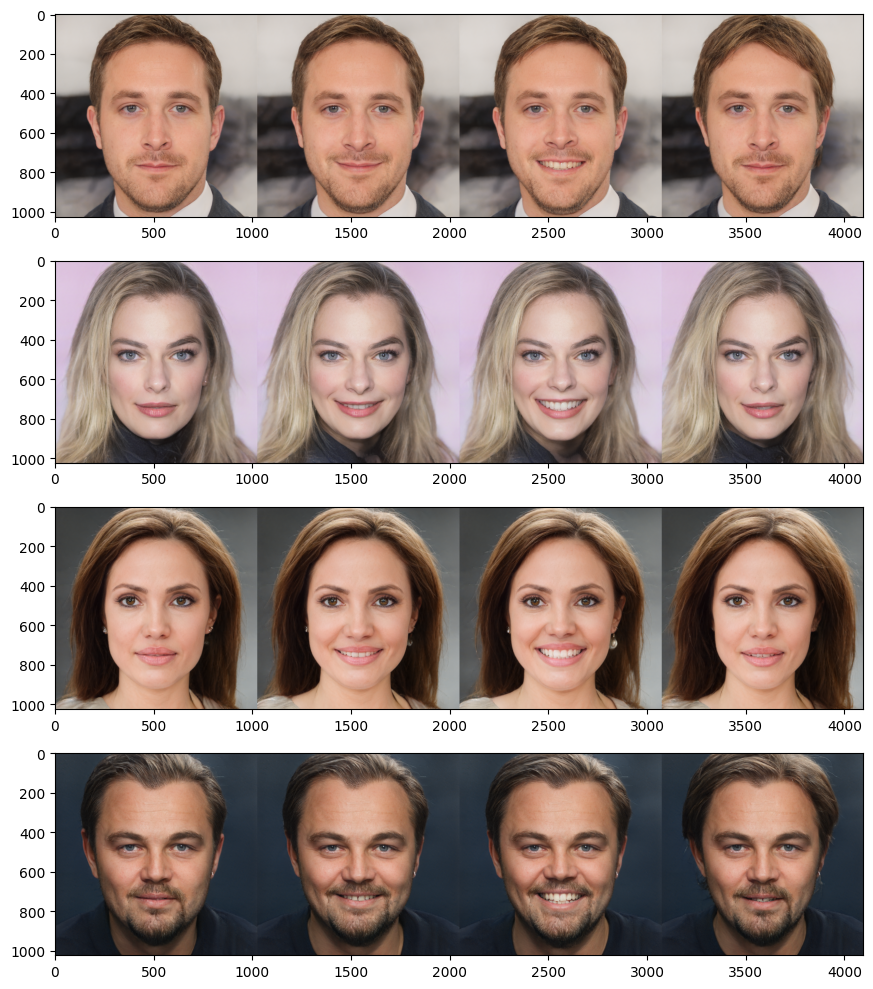

In [ ]:
rows = 4
cols = 1
axes = []
fig = plt.figure()
for i in range(rows):
    img = np.asarray(img_list[i])
    axes.append(fig.add_subplot(rows, cols, i+1))
    plt.imshow(img)
fig.tight_layout()
plt.show()

# Face swap

In [ ]:
import PIL
import os
import numpy as np
import torch
import lpips
import torch.nn as nn
import torchvision.transforms as transforms
from pytorch_msssim import ms_ssim
from stylegan2_models.arcface_model import get_model
import torch.nn.functional as F
from stylegan2_models.e4e.model_utils import load_e4e_standalone
import torchvision.transforms as transforms


def image2tensor_norm(image):
    transform = transforms.Compose([transforms.ToTensor(),
                                   transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    tensor = transform(image)
    return tensor



class Arcface_Loss(nn.Module):
    def __init__(self, weights_path, device):
        super().__init__()

        self.arcnet = get_model("r50", fp16=False)
        self.arcnet.load_state_dict(torch.load(weights_path))
        self.arcnet.eval()
        self.arcnet.to(device)

        self.cosin_loss = nn.CosineSimilarity(dim=1, eps=1e-6)

    def forward(self, source, synth):

        source = F.interpolate(source,size=(112,112), mode='bicubic')
        synth = F.interpolate(synth,size=(112,112), mode='bicubic')

        emb1 = self.arcnet(source)
        emb2 = self.arcnet(synth)
        loss = (1 - self.cosin_loss(emb1, emb2))[0]
        return loss

arcface_path = "/content/drive/MyDrive/ms1mv3_arcface_r50_fp16.pth"

In [ ]:
list_of_faces = ["/content/drive/MyDrive/aligned_images/MRobbie/0.jpg",
                 "/content/drive/MyDrive/aligned_images/RGosling/0.jpg",
                 "/content/drive/MyDrive/aligned_images/AJolie/0.jpg",
                 "/content/drive/MyDrive/aligned_images/LDCaprio/0.jpg",
                 "/content/drive/MyDrive/aligned_images/LDCaprio/2.jpg",
                 "/content/drive/MyDrive/aligned_images/MRobbie/2.jpg"]

In [ ]:
def face_swap(img_base, img_swap):
    target_pil = Image.open(img_base).convert('RGB')
    target_tensor = image2tensor_norm(target_pil).to(device).unsqueeze(0)
    target_pil_arc = Image.open(img_swap).convert('RGB')
    target_tensor_arc = image2tensor_norm(target_pil_arc).to(device).unsqueeze(0)
  # инициализируем функции потерь
    lpips_loss = Lpips_loss(device)
    rec_loss = Rec_loss()
    arc_loss =  Arcface_Loss(arcface_path,device)

    noise_bufs = { name: buf for (name, buf) in G.synthesis.named_buffers() if 'noise_const' in name }
    reg_loss = Reg_loss(noise_bufs)

  #  loss weights
    regularize_noise_weight = 5e5
    rec_weight = 0.4
    lpips_weoght = 0.9
    arc_weight = 0.7
  # Параметры для оптимизации
    num_steps = 180
    seed = 42
    initial_learning_rate = 0.05
    w_avg_samples = 10000

  # Получаем средний вектор латентного пространства
    z_samples = torch.from_numpy(np.random.RandomState(seed).randn(w_avg_samples, G.z_dim)).to(device)
    w_samples = G.mapping(z_samples, None)
    w_samples = w_samples[:, :1, :].cpu().numpy().astype(np.float32)
    w_avg = np.mean(w_samples, axis=0, keepdims=True)   # [1, 1, C]
    w_std = (np.sum((w_samples - w_avg) ** 2) / w_avg_samples) ** 0.5

  # w or w_plus
    w_opt = torch.tensor(w_avg, dtype=torch.float32, device=device, requires_grad=False) # pylint: disable=not-callable
    w_opt = broadcast_w_sg(w_opt).requires_grad_(True)

  # w_opt = torch.tensor(w_avg, dtype=torch.float32, device=device, requires_grad=True) # pylint: disable=not-callable

    optimizer = torch.optim.Adam([w_opt], lr=initial_learning_rate)
    generated_tensors = []
    for step in tqdm(range(num_steps)):
        synth_tensor = G.synthesis(broadcast_w_sg(w_opt), noise_mode='const')

        lpips_value = lpips_loss(synth_tensor, target_tensor)
        rec_value = rec_loss(synth_tensor, target_tensor)
        reg_value = reg_loss()
        arc_value = arc_loss(synth_tensor, target_tensor_arc)

        loss = lpips_value*lpips_weoght + rec_value*rec_weight + arc_value*arc_weight + reg_value*regularize_noise_weight

        optimizer.step()
        optimizer.zero_grad(set_to_none=True)
        loss.backward()

        generated_tensors.append(synth_tensor)
    generated_tensor = G.synthesis(broadcast_w_sg(w_opt), noise_mode='const', force_fp32=True)
    return generated_tensor


In [ ]:
faces_tensors_list = []
for i in range(len(list_of_faces)):
  for j in range (len(list_of_faces)):
    generated = face_swap(list_of_faces[i], list_of_faces[j])
    faces_tensors_list.append(generated)

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:04<00:00, 126MB/s]


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth
Setting up PyTorch plugin "bias_act_plugin"... Done.


  0%|          | 0/180 [00:00<?, ?it/s]

Setting up PyTorch plugin "upfirdn2d_plugin"... Done.


100%|██████████| 180/180 [02:42<00:00,  1.11it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.45it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.45it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.45it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.45it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.45it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 180/180 [02:04<00:00,  1.45it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


 69%|██████▉   | 124/180 [01:25<00:38,  1.45it/s]

In [ ]:
def plt_img(target_pil, target_pil_arc, tensor):
  rows = 1
  cols = 3
  axes = []
  fig = plt.figure()

  axes.append(fig.add_subplot(rows, cols, 1))
  plt.imshow(target_pil_arc)

  tensor = (tensor.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
  img = Image.fromarray(tensor[0].cpu().numpy(), 'RGB')
  axes.append(fig.add_subplot(rows, cols, 2))

  plt.imshow(img)

  axes.append(fig.add_subplot(rows, cols, 3))
  plt.imshow(target_pil)
  fig.tight_layout()
  plt.show()

In [ ]:
target_pil = Image.open("/content/drive/MyDrive/aligned_images/AJolie/0.jpg").convert('RGB')
target_pil_arc = Image.open("/content/drive/MyDrive/aligned_images/MRobbie/0.jpg").convert('RGB')

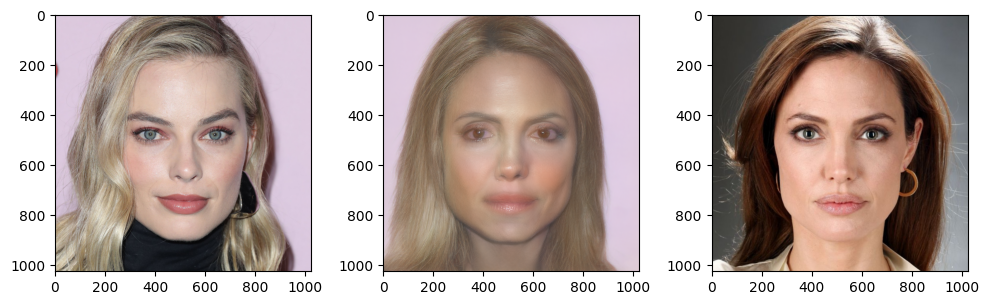

In [ ]:
plt_img(target_pil, target_pil_arc, faces_tensors_list[2])

In [ ]:
target_pil = Image.open("/content/drive/MyDrive/aligned_images/LDCaprio/0.jpg").convert('RGB')
target_pil_arc = Image.open("/content/drive/MyDrive/aligned_images/MRobbie/0.jpg").convert('RGB')

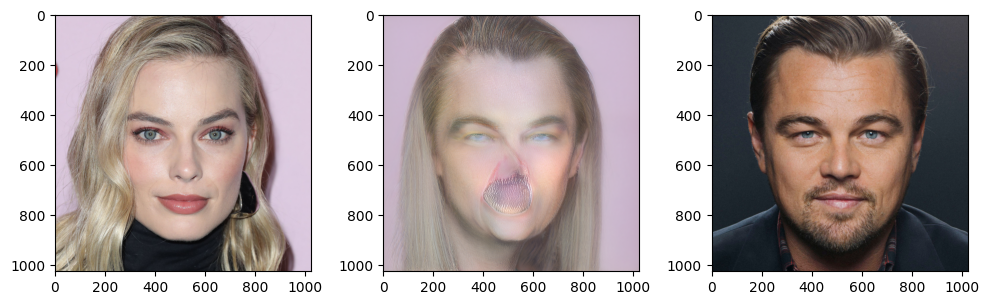

In [ ]:
plt_img(target_pil, target_pil_arc, faces_tensors_list[3])

In [ ]:
target_pil = Image.open("/content/drive/MyDrive/aligned_images/LDCaprio/2.jpg").convert('RGB')
target_pil_arc = Image.open("/content/drive/MyDrive/aligned_images/MRobbie/0.jpg").convert('RGB')

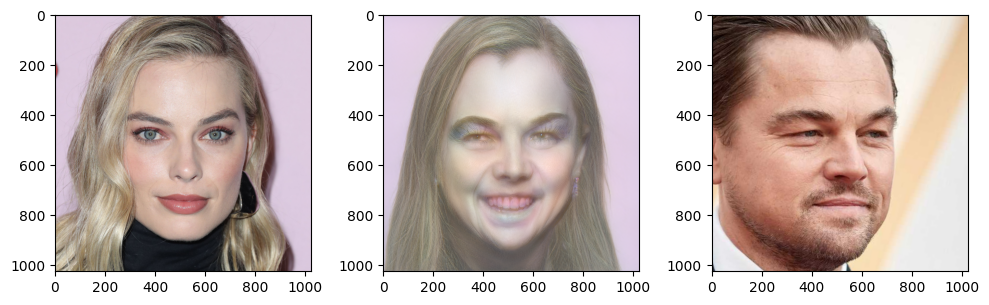

In [ ]:
plt_img(target_pil, target_pil_arc, faces_tensors_list[4])

Непонятный артефакт в виде улыбки

In [ ]:
target_pil = Image.open("/content/drive/MyDrive/aligned_images/AJolie/0.jpg").convert('RGB')
target_pil_arc = Image.open("/content/drive/MyDrive/aligned_images/RGosling/0.jpg").convert('RGB')

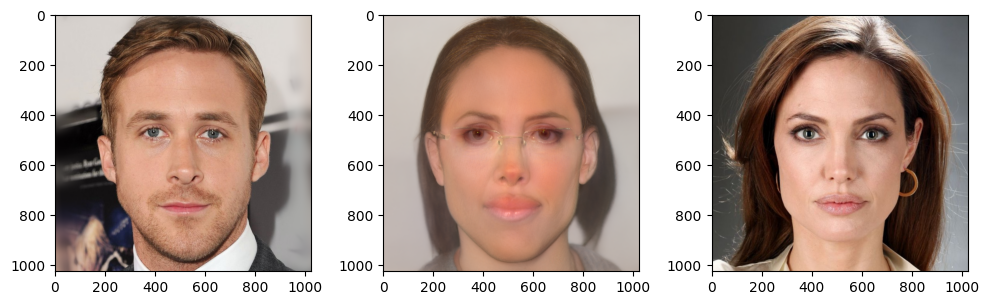

In [ ]:
plt_img(target_pil, target_pil_arc, faces_tensors_list[8])

In [ ]:
target_pil = Image.open("/content/drive/MyDrive/aligned_images/LDCaprio/0.jpg").convert('RGB')
target_pil_arc = Image.open("/content/drive/MyDrive/aligned_images/RGosling/0.jpg").convert('RGB')

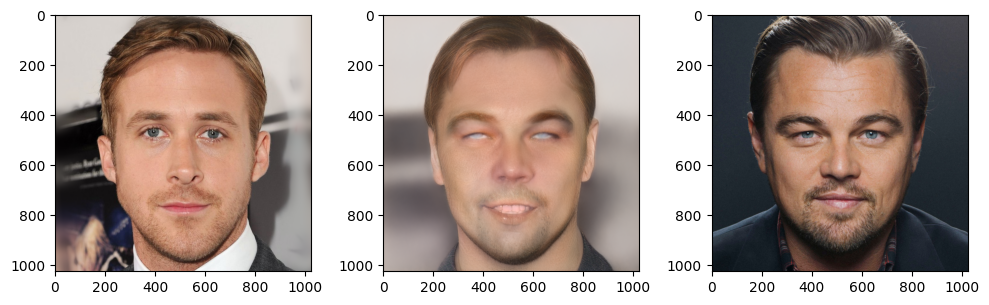

In [ ]:
plt_img(target_pil, target_pil_arc, faces_tensors_list[9])